<a href="https://colab.research.google.com/github/Aaront2002/Jujuboi/blob/main/data_challenge_test_working_version2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras import datasets, layers, models, optimizers
from keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np

from IPython.display import Image, display
import PIL
import os

In [2]:
!nvidia-smi

Fri Nov  1 12:16:24 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
!pip install -q fiftyone
!git clone https://github.com/EscVM/OIDv4_ToolKit.git
%cd OIDv4_ToolKit
!pip install -r requirements.txt




fatal: destination path 'OIDv4_ToolKit' already exists and is not an empty directory.
/content/OIDv4_ToolKit


In [4]:
!python3 main.py downloader --classes Scarf --type_csv train --limit 500 --multiclasses 1
!python3 main.py downloader --classes Scarf --type_csv validation --limit 500 --multiclasses 1








		   ___   _____  ______            _    _    
		 .'   `.|_   _||_   _ `.         | |  | |   
		/  .-.  \ | |    | | `. \ _   __ | |__| |_  
		| |   | | | |    | |  | |[ \ [  ]|____   _| 
		\  `-'  /_| |_  _| |_.' / \ \/ /     _| |_  
		 `.___.'|_____||______.'   \__/     |_____|
	

             _____                    _                 _             
            (____ \                  | |               | |            
             _   \ \ ___  _ _ _ ____ | | ___   ____  _ | | ____  ____ 
            | |   | / _ \| | | |  _ \| |/ _ \ / _  |/ || |/ _  )/ ___)
            | |__/ / |_| | | | | | | | | |_| ( ( | ( (_| ( (/ /| |    
            |_____/ \___/ \____|_| |_|_|\___/ \_||_|\____|\____)_|    
                                                          
        
    [INFO] | Downloading ['Scarf'] together.
   [ERROR] | Missing the class-descriptions-boxable.csv file.
[DOWNLOAD] | Do you want to download the missing file? [Y/n] Y
...145%, 0 MB, 31227 KB/s, 0 seconds passed
[DOWNLO

In [5]:
!python3 main.py downloader --classes Human_face --type_csv train --limit 500 --multiclasses 1
!python3 main.py downloader --classes Human_face --type_csv validation --limit 500 --multiclasses 1




		   ___   _____  ______            _    _    
		 .'   `.|_   _||_   _ `.         | |  | |   
		/  .-.  \ | |    | | `. \ _   __ | |__| |_  
		| |   | | | |    | |  | |[ \ [  ]|____   _| 
		\  `-'  /_| |_  _| |_.' / \ \/ /     _| |_  
		 `.___.'|_____||______.'   \__/     |_____|
	

             _____                    _                 _             
            (____ \                  | |               | |            
             _   \ \ ___  _ _ _ ____ | | ___   ____  _ | | ____  ____ 
            | |   | / _ \| | | |  _ \| |/ _ \ / _  |/ || |/ _  )/ ___)
            | |__/ / |_| | | | | | | | | |_| ( ( | ( (_| ( (/ /| |    
            |_____/ \___/ \____|_| |_|_|\___/ \_||_|\____|\____)_|    
                                                          
        
    [INFO] | Downloading ['Human face'] together.

Human face
    [INFO] | Downloading train images.
    [INFO] | [INFO] Found 331627 online images for train.
    [INFO] | Limiting to 500 images.
    [INFO] | Download of 

In [6]:
import os

# List some images in the directory
print(os.listdir('/content/OIDv4_ToolKit/OID/Dataset/train/Human face')[:10])


['dcf650dde0dfbd78.jpg', '1b71b9dae19da65c.jpg', '9d6dcace0ea4b9ae.jpg', 'fad626f117e5f2a0.jpg', '8fbcd769c2e4a59a.jpg', '613b966bc7d1845a.jpg', '5c08a336568d5476.jpg', '1264248ad35732db.jpg', 'eaea04956702d209.jpg', 'bd043ee8fdb943c4.jpg']


In [7]:
ds_training = keras.utils.image_dataset_from_directory(
    directory="/content/OIDv4_ToolKit/OID/Dataset/train",
    labels='inferred',
    class_names=["Scarf", "Human face"],
    label_mode='categorical',
    batch_size=48,
    image_size= (250,250)
)

Found 1000 files belonging to 2 classes.


In [8]:
ds_validation = keras.utils.image_dataset_from_directory(
    directory="/content/OIDv4_ToolKit/OID/Dataset/validation",
    labels='inferred',
    class_names=["Scarf", "Human face"],
    label_mode='categorical',
    batch_size=48,
    image_size= (250,250)
)

Found 521 files belonging to 2 classes.


In [9]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3,3), activation='relu',input_shape=(250,250,3)))
model.add(layers.MaxPooling2D((2,2)))
model.add(layers.Flatten())
model.add(layers.Dense(100, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))
model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 248, 248, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 124, 124, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 492032)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 100)                 │      49,203,300 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 2)                   │             202 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 49,204,398 (187.70 MB)

 Trainable params: 49,204,398 (187.70 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
checkpoint_filepath = '/tmp/checkpoint.weights.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [11]:
model.compile(optimizer="adam",
              loss='categorical_crossentropy',
              metrics=['accuracy'])

history = model.fit(ds_training, epochs=20, validation_data= ds_validation,
                    callbacks=[model_checkpoint_callback])

Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 23s 833ms/step - accuracy: 0.4711 - loss: 4677.9248 - val_accuracy: 0.6852 - val_loss: 191.9999
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 29s 502ms/step - accuracy: 0.5671 - loss: 386.7225 - val_accuracy: 0.3512 - val_loss: 306.5766
Epoch 3/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 8s 387ms/step - accuracy: 0.7087 - loss: 92.3576 - val_accuracy: 0.4856 - val_loss: 89.5556
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 9s 443ms/step - accuracy: 0.8892 - loss: 10.8306 - val_accuracy: 0.6008 - val_loss: 60.8241
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 12s 595ms/step - accuracy: 0.9544 - loss: 3.3109 - val_accuracy: 0.7274 - val_loss: 33.0398
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 26s 866ms/step - accuracy: 0.9843 - loss: 0.6978 - val_accuracy: 0.7466 - val_loss: 29.9799
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 12s 445ms/step - accuracy: 0.9896 - loss: 0.1880 - val_accuracy: 0.5528 - val_loss: 63.2434
Epoch 8/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 9s 443ms/step - accuracy: 0.9903 - loss: 0.24

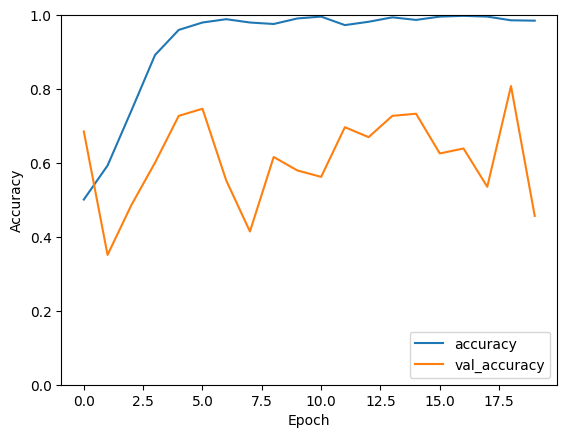

In [12]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

In [13]:
!python3 main.py downloader --classes Scarf --type_csv test --limit 10 --multiclasses 1


		   ___   _____  ______            _    _    
		 .'   `.|_   _||_   _ `.         | |  | |   
		/  .-.  \ | |    | | `. \ _   __ | |__| |_  
		| |   | | | |    | |  | |[ \ [  ]|____   _| 
		\  `-'  /_| |_  _| |_.' / \ \/ /     _| |_  
		 `.___.'|_____||______.'   \__/     |_____|
	

             _____                    _                 _             
            (____ \                  | |               | |            
             _   \ \ ___  _ _ _ ____ | | ___   ____  _ | | ____  ____ 
            | |   | / _ \| | | |  _ \| |/ _ \ / _  |/ || |/ _  )/ ___)
            | |__/ / |_| | | | | | | | | |_| ( ( | ( (_| ( (/ /| |    
            |_____/ \___/ \____|_| |_|_|\___/ \_||_|\____|\____)_|    
                                                          
        
    [INFO] | Downloading ['Scarf'] together.
   [ERROR] | Missing the test-annotations-bbox.csv file.
[DOWNLOAD] | Do you want to download the missing file? [Y/n] Y
...100%, 49 MB, 14766 KB/s, 3 seconds passed
[DOWNLOAD] 

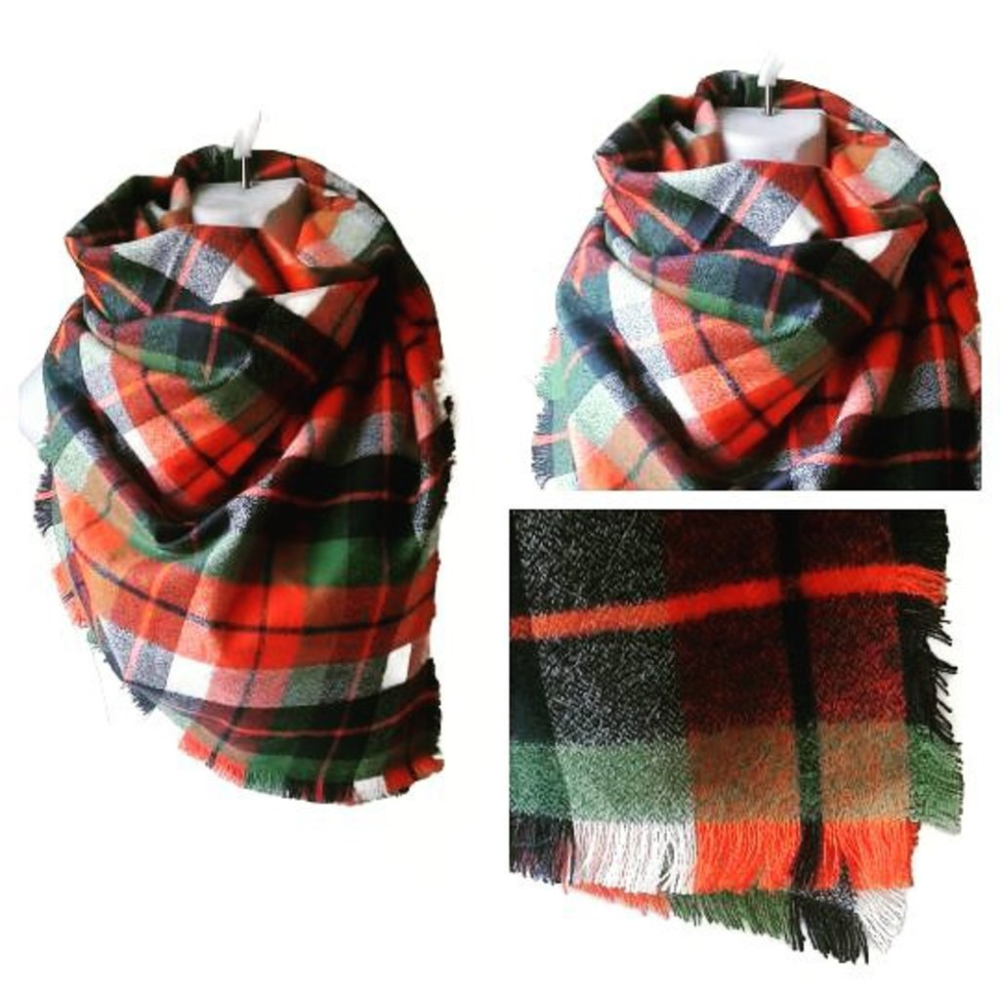

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Probability that the image contains Scarf: 100.00 %


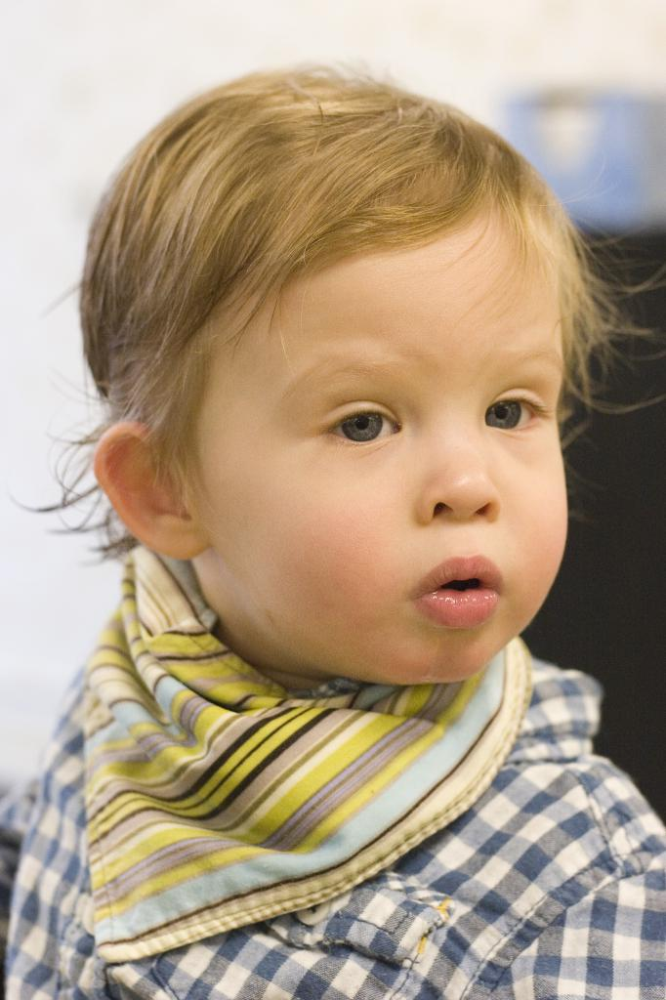

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Probability that the image contains Scarf: 100.00 %


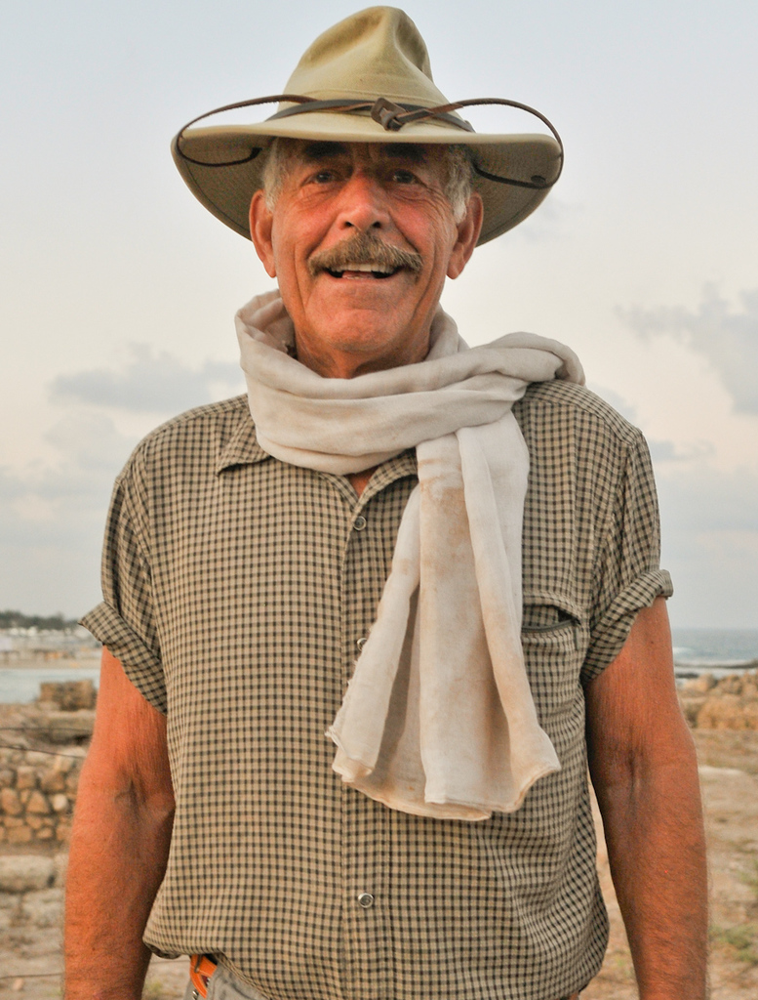

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Probability that the image contains Scarf: 100.00 %


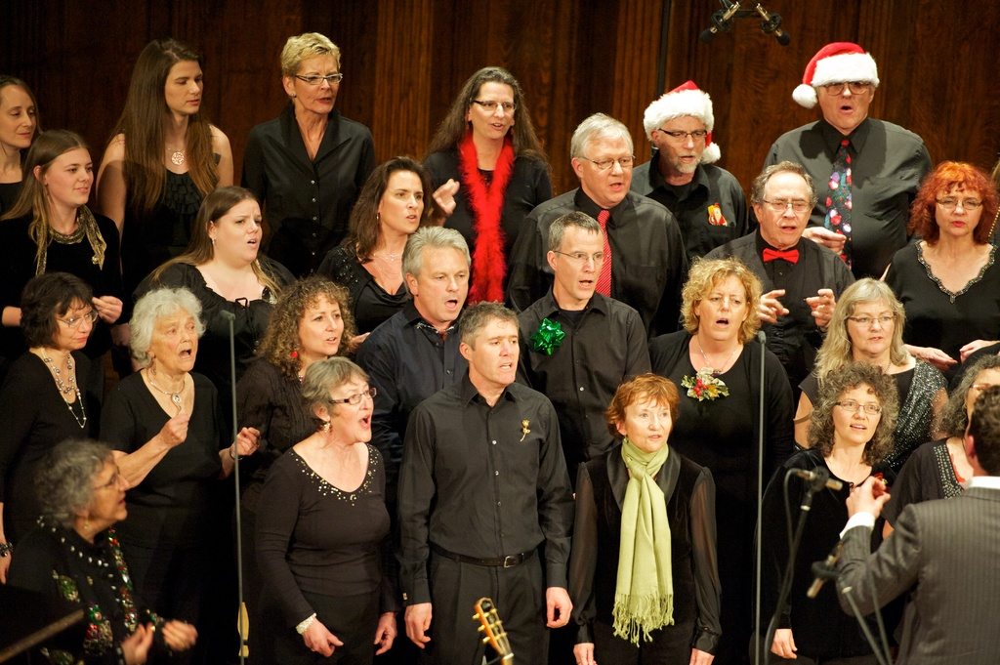

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Probability that the image contains Scarf: 0.00 %


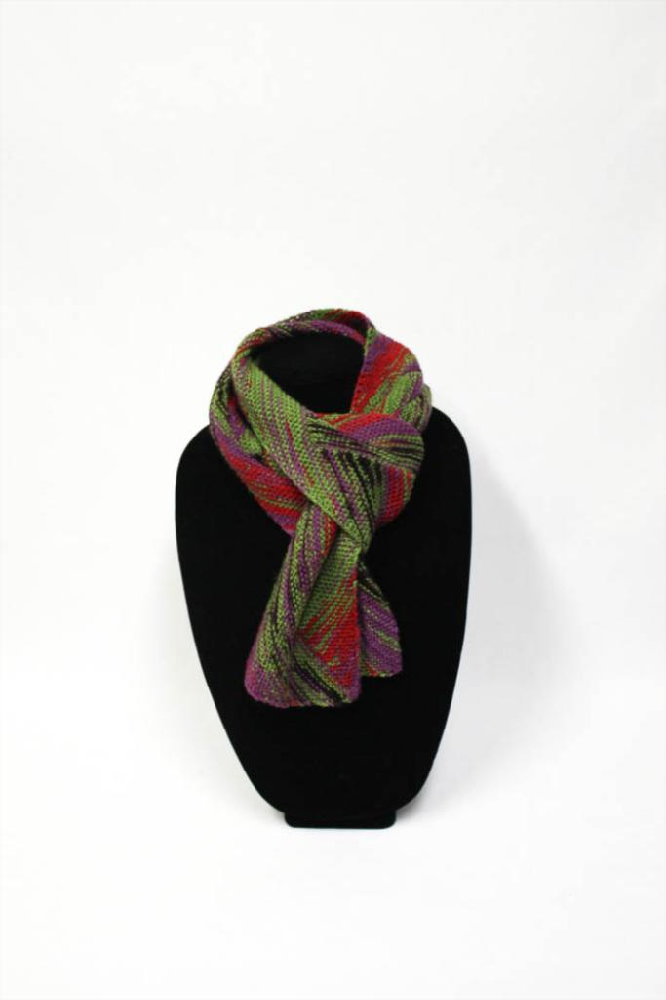

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Probability that the image contains Scarf: 100.00 %


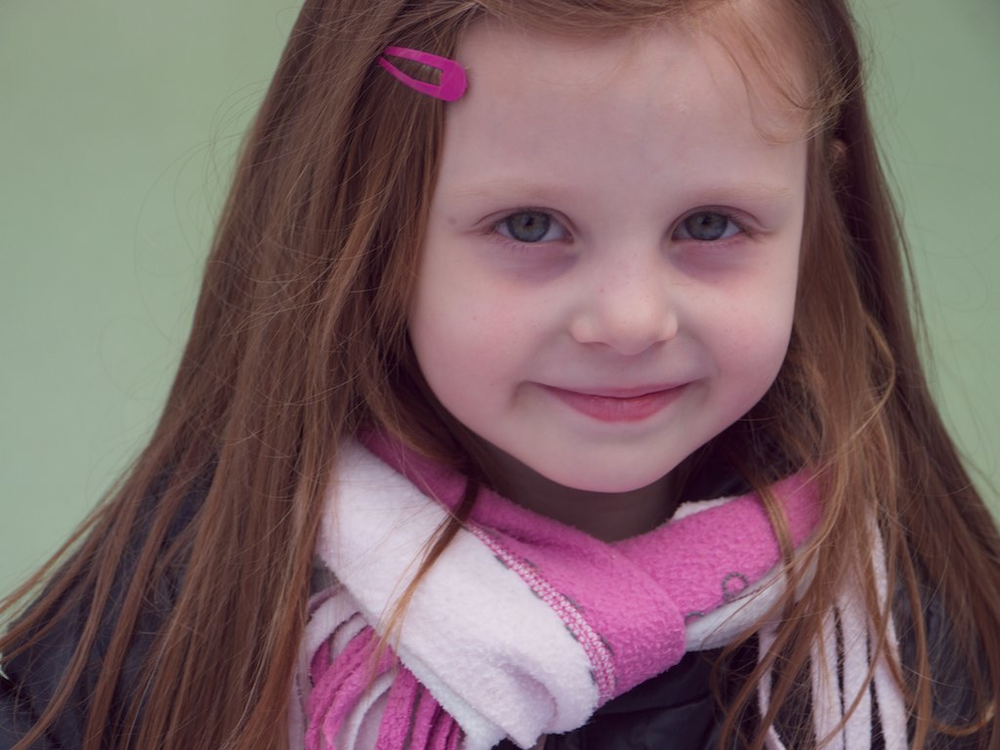

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Probability that the image contains Scarf: 100.00 %


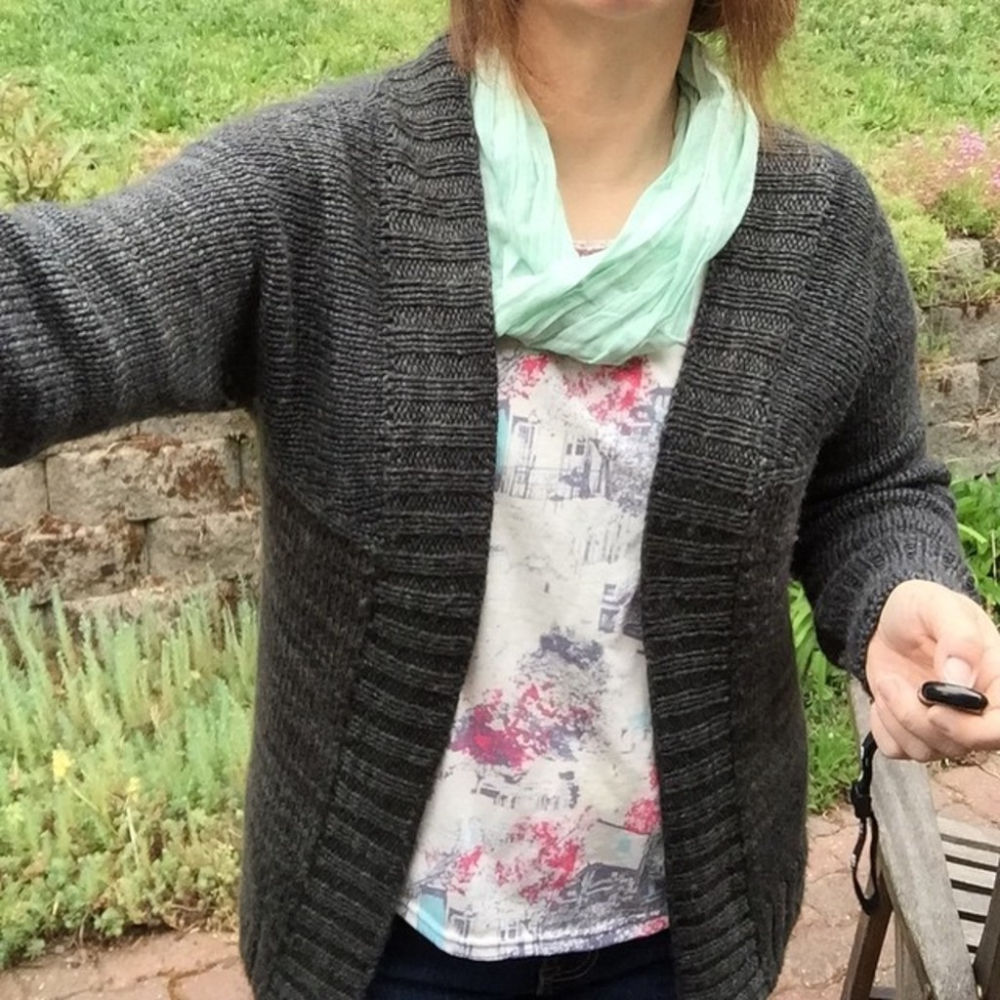

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Probability that the image contains Scarf: 100.00 %


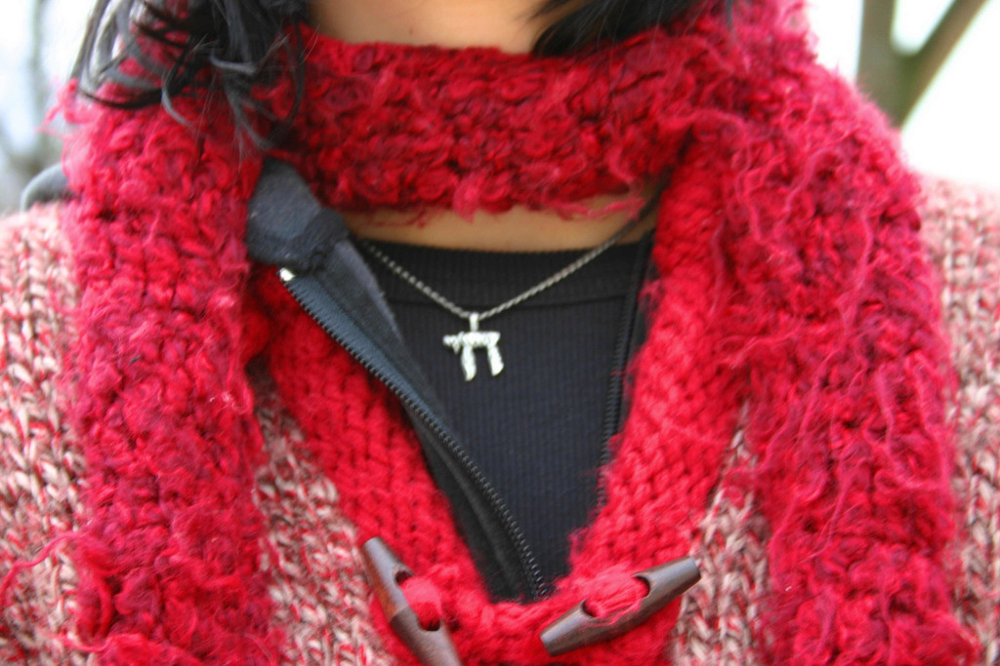

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Probability that the image contains Scarf: 100.00 %


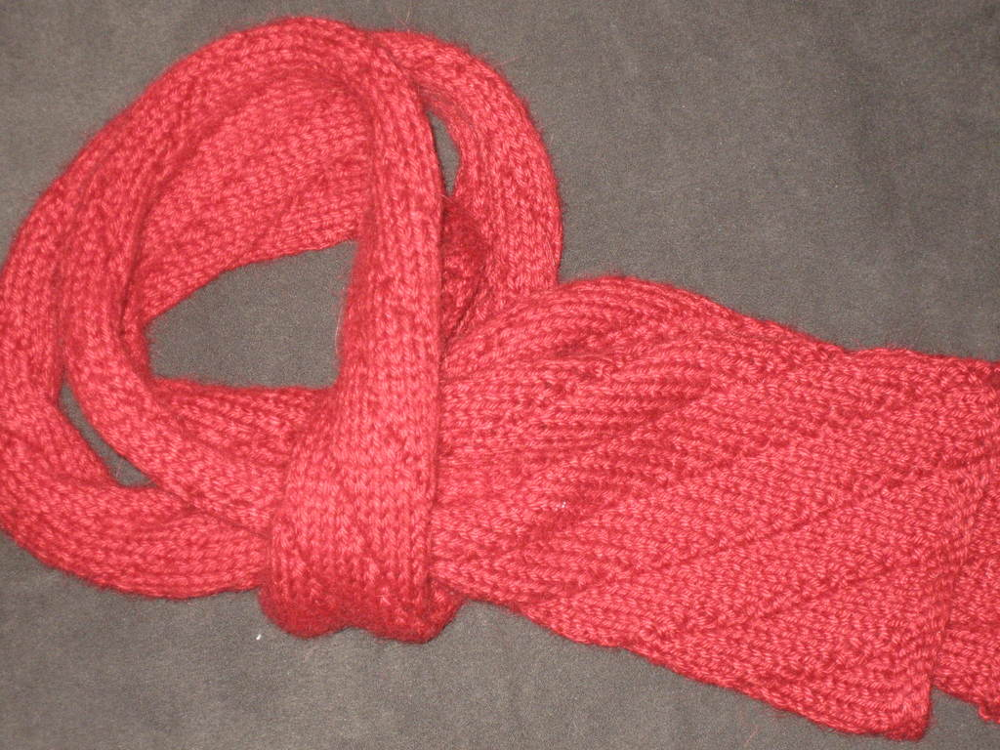

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Probability that the image contains Scarf: 100.00 %


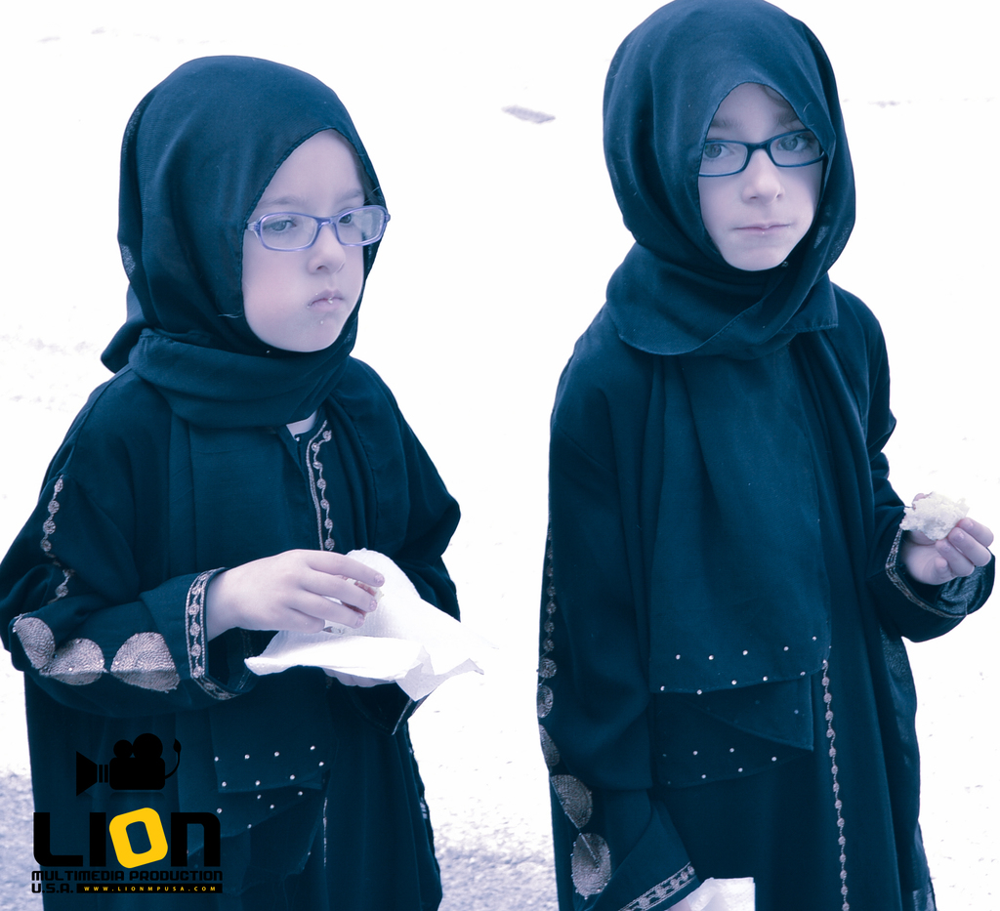

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Probability that the image contains Scarf: 100.00 %


In [15]:
for filename in os.listdir('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf'):
    # Check if the file is an image before attempting to display it
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        display(Image(os.path.join('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf', filename), width=250, height=250))
        pred=tf.keras.utils.load_img(os.path.join('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf', filename), target_size=(250,250))
        pred=tf.keras.utils.img_to_array(pred)
        pred=np.expand_dims(pred, axis=0)
        prediction = model.predict(pred)
        print("Probability that the image contains Scarf: " + str("{:1.2f}".format(float(prediction[0][0])*100)) + " %")


Found 1000 images belonging to 2 classes.
Found 521 images belonging to 2 classes.
Number of samples in training set: 1000
Number of samples in validation set: 521


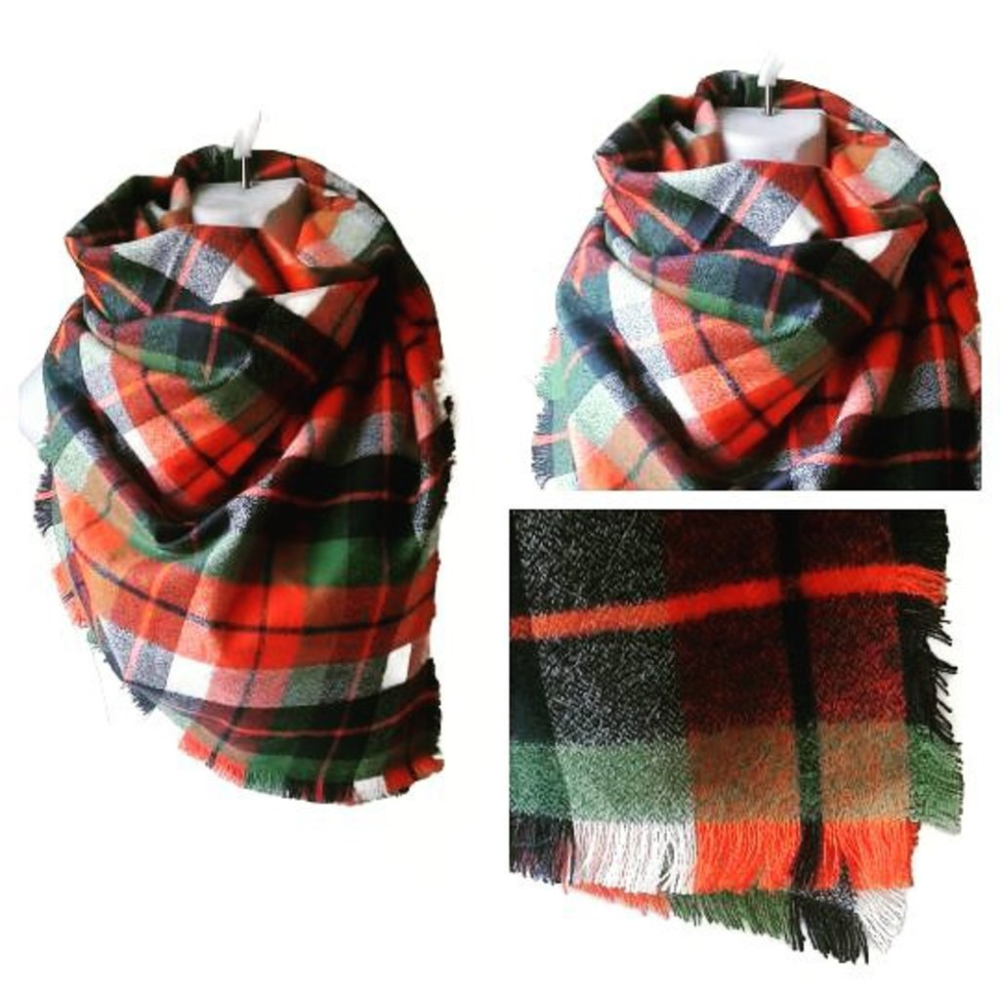

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
Probability that the image contains Scarf: 100.00 %


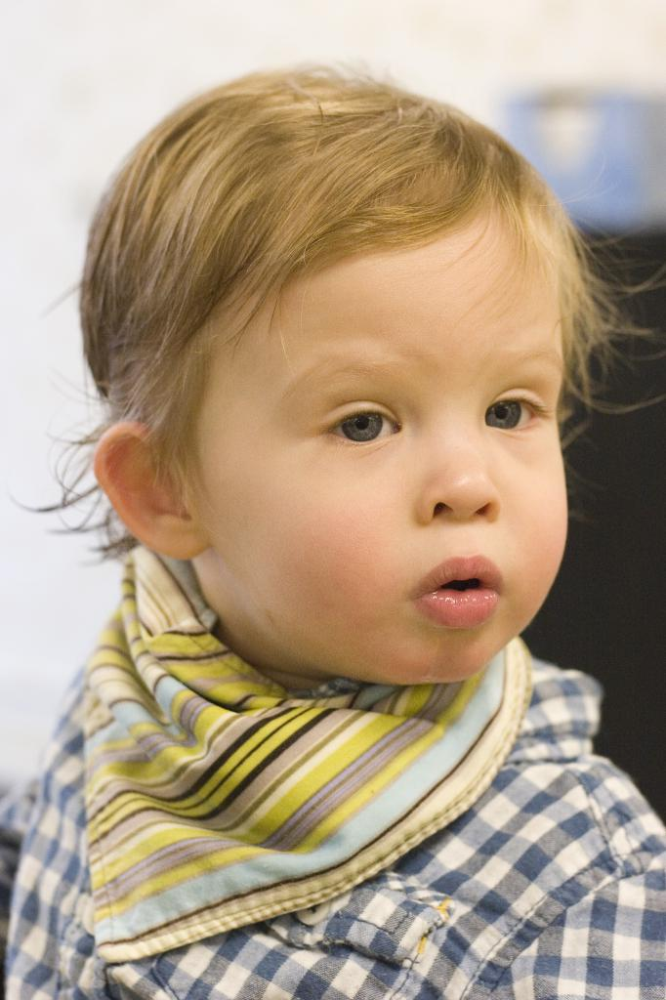

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Probability that the image contains Scarf: 100.00 %


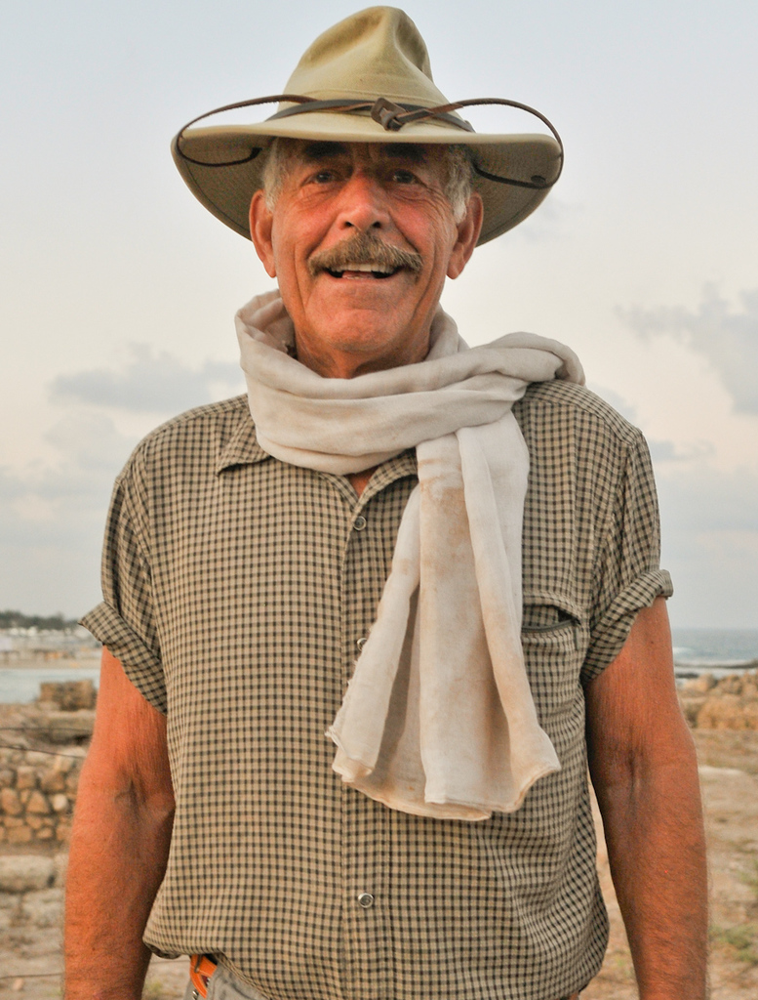

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Probability that the image contains Scarf: 100.00 %


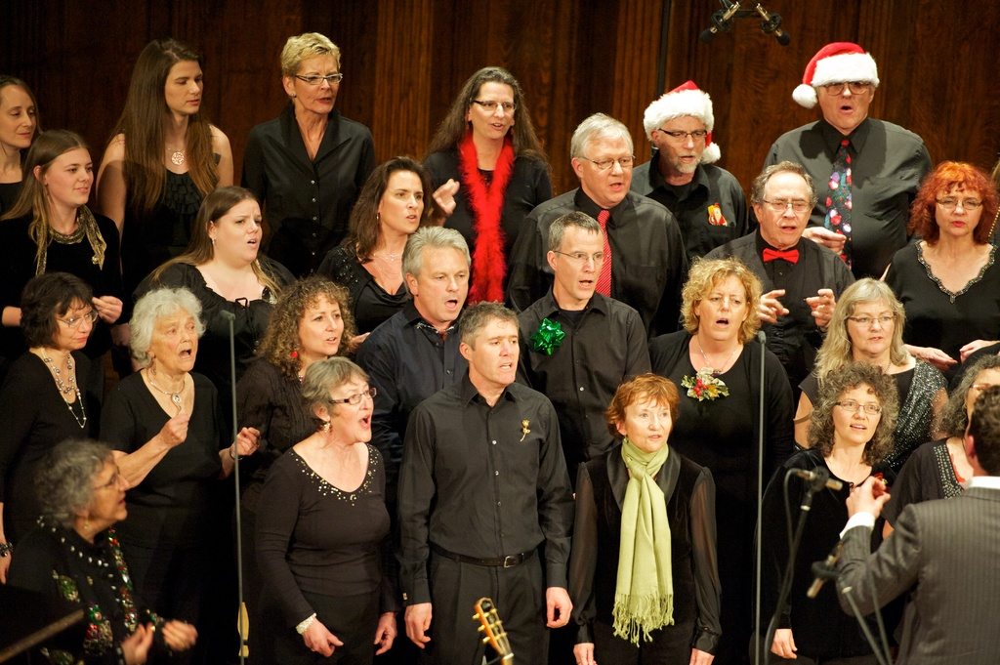

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Probability that the image contains Scarf: 100.00 %


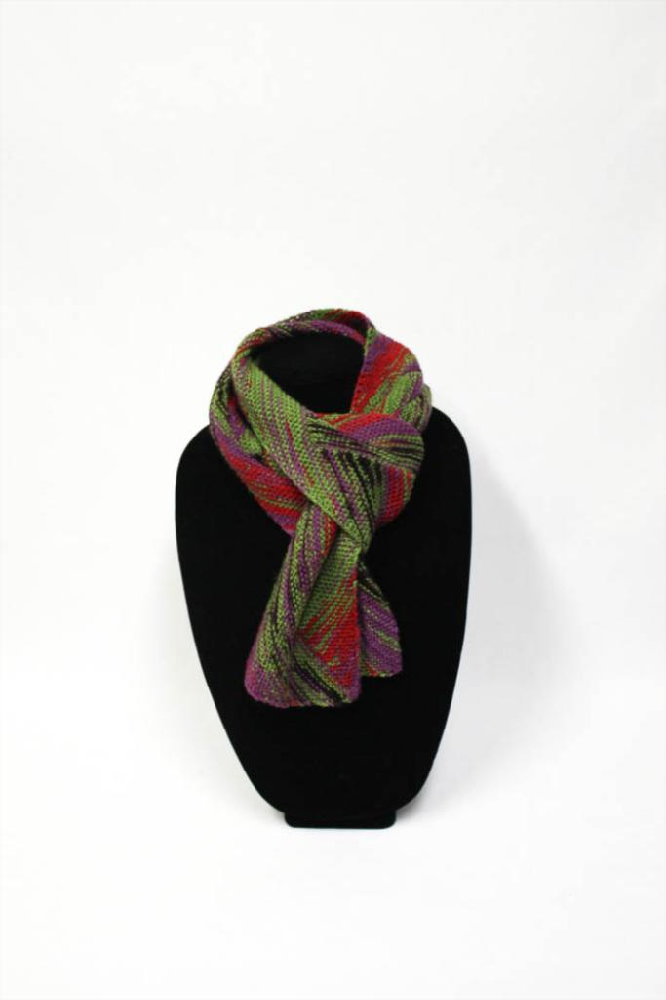

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Probability that the image contains Scarf: 100.00 %


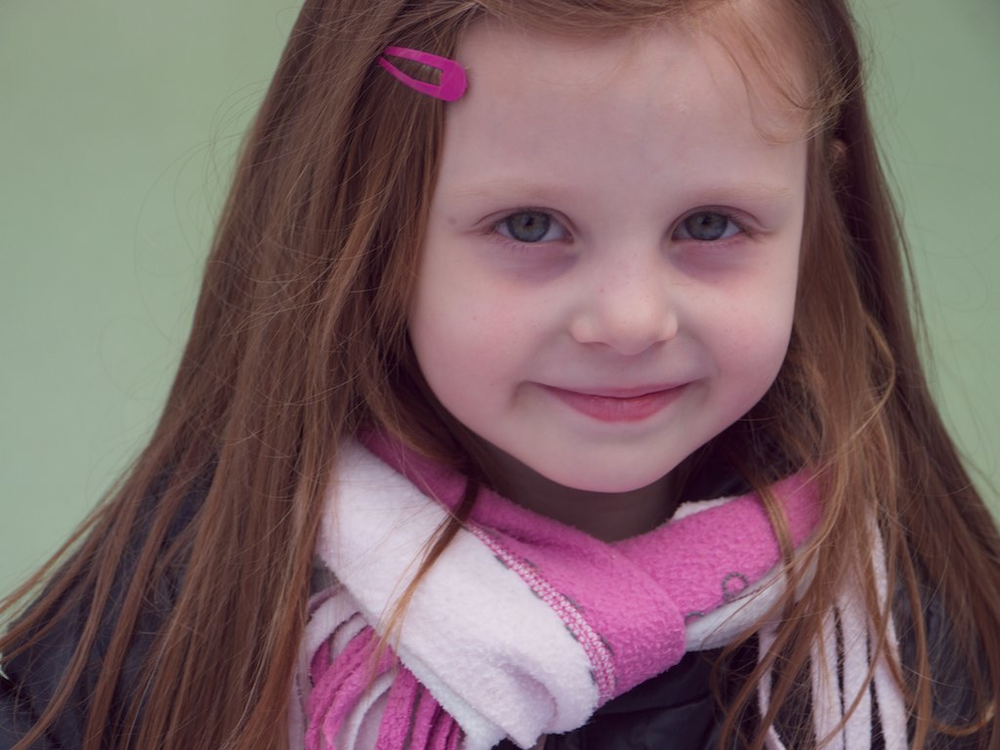

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Probability that the image contains Scarf: 100.00 %


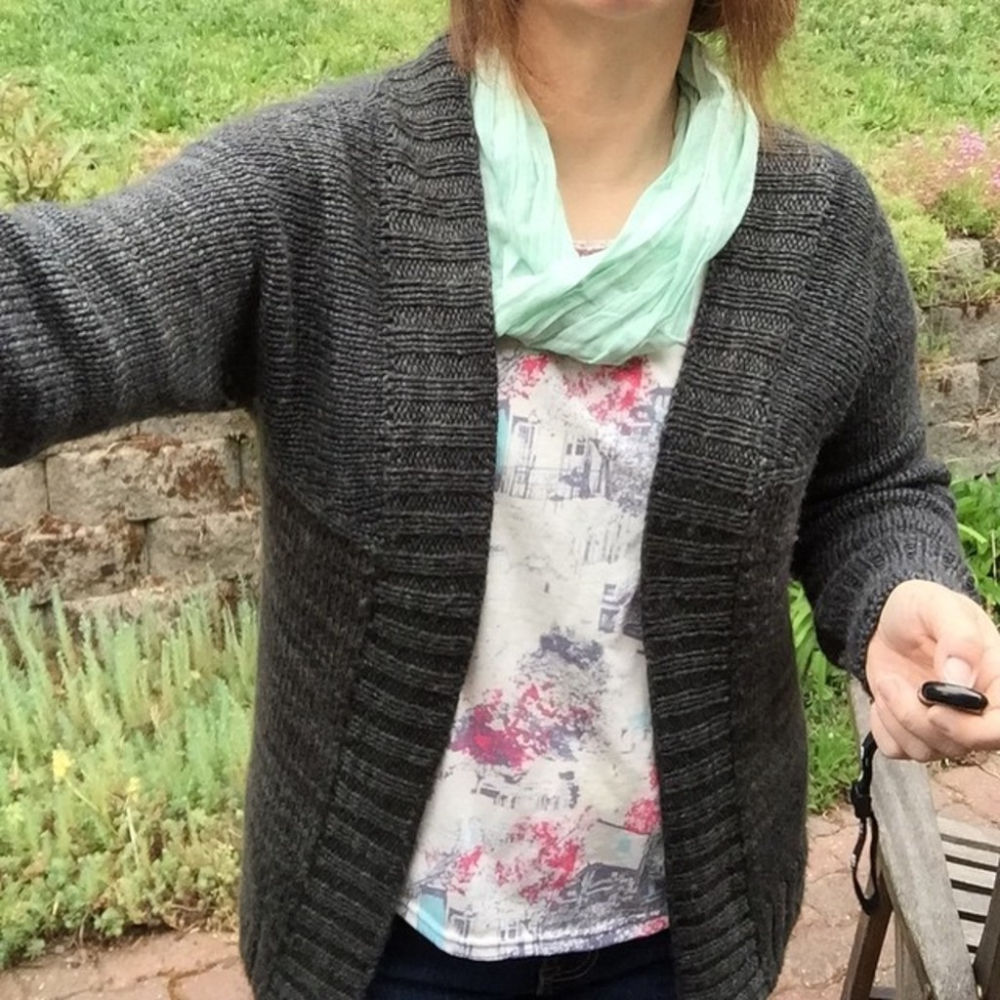

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Probability that the image contains Scarf: 100.00 %


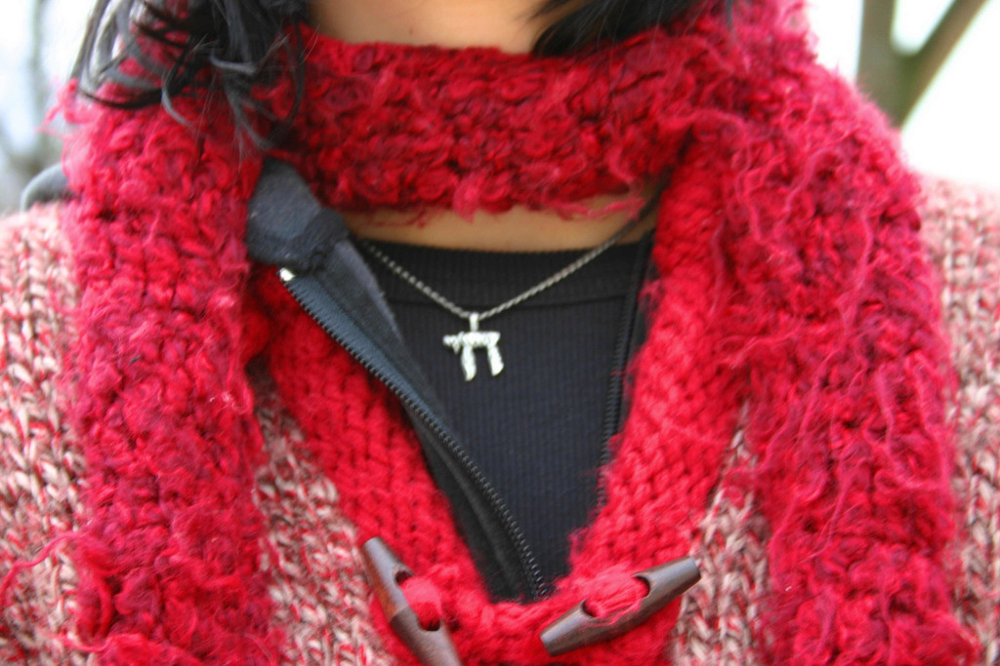

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Probability that the image contains Scarf: 100.00 %


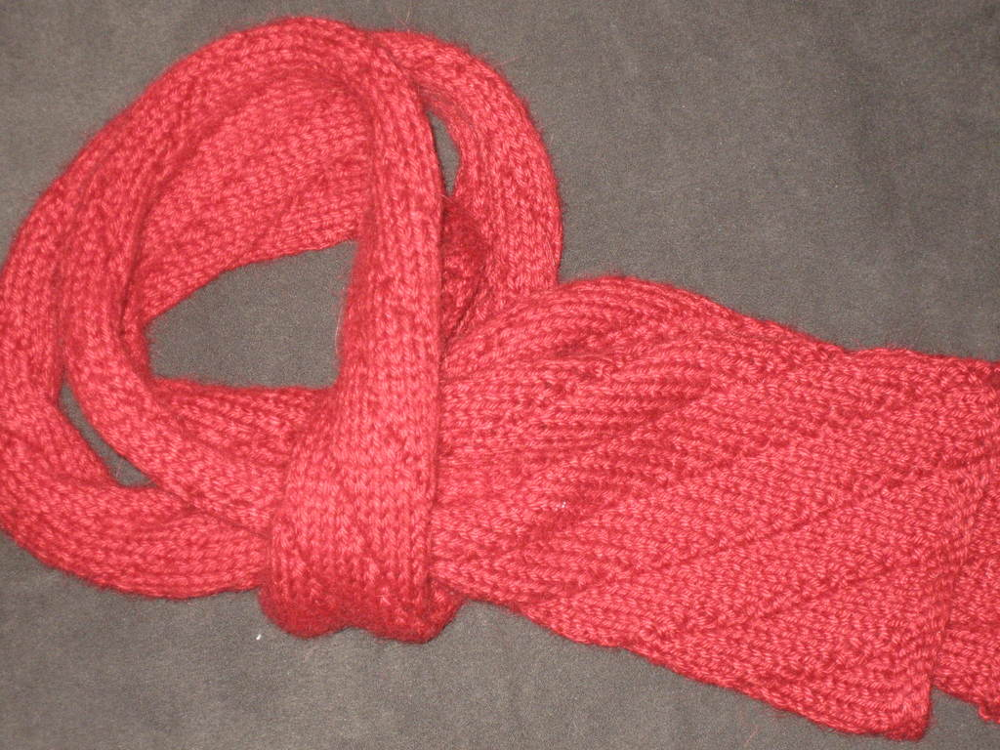

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Probability that the image contains Scarf: 100.00 %


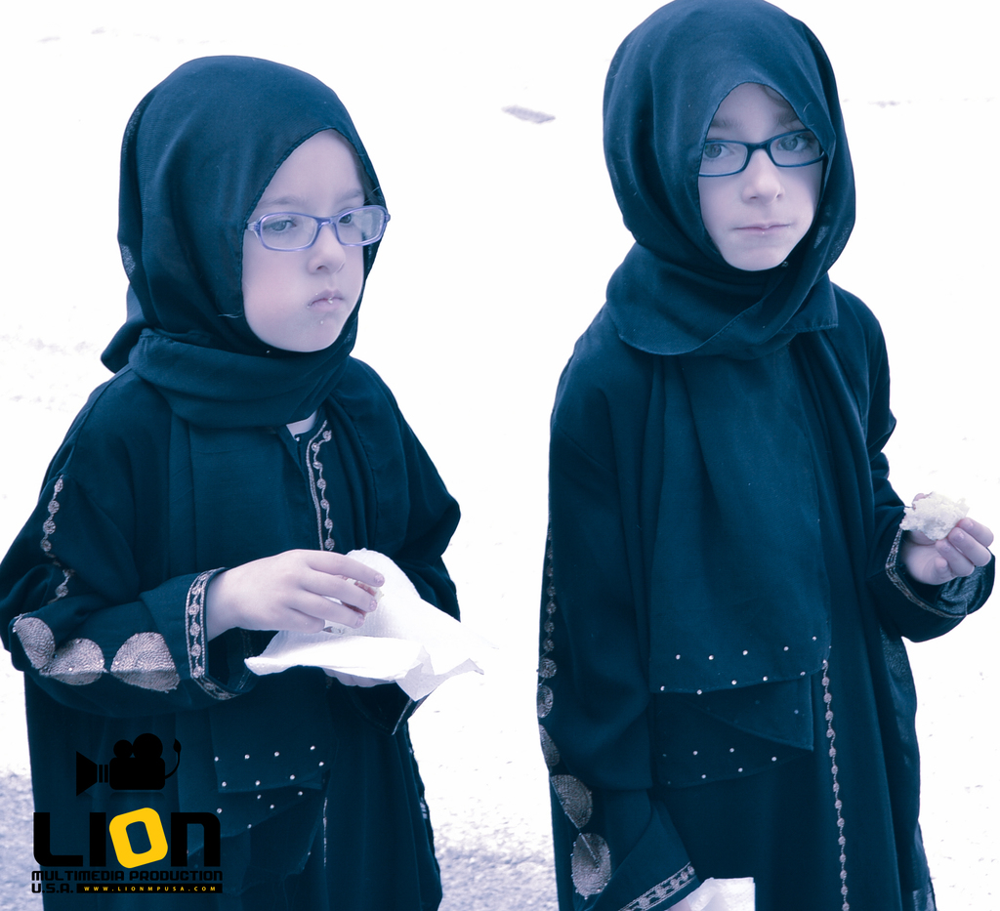

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Probability that the image contains Scarf: 100.00 %


In [11]:
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np
import os

# Import the necessary library
from IPython.display import Image, display
import fnmatch  # Import fnmatch for case-insensitive file matching

    # ... (other imports and code)

    # Function to find image files with case-insensitive extensions
def find_images(directory):
        image_files = []
        for filename in os.listdir(directory):
            if fnmatch.fnmatch(filename.lower(), '*.jpg') or \
               fnmatch.fnmatch(filename.lower(), '*.jpeg') or \
               fnmatch.fnmatch(filename.lower(), '*.png'):
                image_files.append(os.path.join(directory, filename))
        return image_files

# Define paths to your training and validation data
train_data_dir = '/content/OIDv4_ToolKit/OID/Dataset/train/'
validation_data_dir = '/content/OIDv4_ToolKit/OID/Dataset/validation/'

# Image dimensions
img_width, img_height = 299, 299

# Data augmentation for training data
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

# Rescaling for validation data
validation_datagen = ImageDataGenerator(rescale=1. / 255)

# Data generators
train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_width, img_height),
    batch_size=16,
    class_mode='categorical',
    # ----> Explicitly specify the classes if needed
    # classes=['Scarf']  # Replace 'Scarf' with your actual class name
)

validation_generator = validation_datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_width, img_height),
    batch_size=16,
    class_mode='categorical',
    # ----> Explicitly specify the classes if needed
    # classes=['Scarf']  # Replace 'Scarf' with your actual class name
)

# --- Check if generators are empty and debug the reason ---
print("Number of samples in training set:", train_generator.samples)
print("Number of samples in validation set:", validation_generator.samples)

# -----> Create or load your model here <-----
# Example of creating a model using InceptionV3:
base_model = InceptionV3(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
predictions = Dense(1, activation='sigmoid')(x) # Assuming binary classification for 'Scarf'
model = Model(inputs=base_model.input, outputs=predictions)

# -----> Now you can use the 'model' variable for prediction <-----
for filename in os.listdir('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf'):
    # Check if the file is an image before attempting to display it
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        display(Image(os.path.join('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf', filename), width=250, height=250))
        # ----> Update target_size to (299, 299)
        pred=tf.keras.utils.load_img(os.path.join('/content/OIDv4_ToolKit/OID/Dataset/test/Scarf', filename), target_size=(299,299))
        pred=tf.keras.utils.img_to_array(pred)
        pred=np.expand_dims(pred, axis=0)
        prediction = model.predict(pred)
        print("Probability that the image contains Scarf: " + str("{:1.2f}".format(float(prediction[0][0])*100)) + " %")





In [12]:
# Load model directly
from transformers import AutoProcessor, CLIPSegForImageSegmentation

processor = AutoProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/380 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/974 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/4.73k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/603M [00:00<?, ?B/s]

In [13]:
!pip install Pillow requests

In [17]:
from PIL import Image
import requests
import os

from transformers import AutoProcessor, AutoModelForZeroShotObjectDetection

processor = AutoProcessor.from_pretrained("google/owlvit-base-patch32")
model = AutoModelForZeroShotObjectDetection.from_pretrained("google/owlvit-base-patch32")


folder_path = "/content/OIDv4_ToolKit/OID/Dataset/test/Scarf"  # Replace with the actual path to your image folder

for filename in os.listdir(folder_path):
    # Check if the file is an image before processing
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        image_path = os.path.join(folder_path, filename)
        image = Image.open(image_path)

        inputs = processor(text=["a scarf"], images=image, return_tensors="pt")
        outputs = model(**inputs)

        # Process the outputs as needed (e.g., extract bounding boxes, scores, etc.)
        # ...

        print(f"Processed image: {filename}")

preprocessor_config.json:   0%|          | 0.00/392 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/775 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/4.42k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/613M [00:00<?, ?B/s]

Processed image: 1c700e2ab79bd411.jpg
Processed image: 71a8b0e5b7782c58.jpg
Processed image: e81e7dcdee1cdb27.jpg
Processed image: 5c3808d4d99ce6d8.jpg
Processed image: fefc7086bbdcee4b.jpg
Processed image: 600319dc8ebae115.jpg
Processed image: 3f11b9cdf3f08e99.jpg
Processed image: 9eb53899d8c6ed75.jpg
Processed image: 8c348820d77274c6.jpg
Processed image: 2c911bdb61a91729.jpg


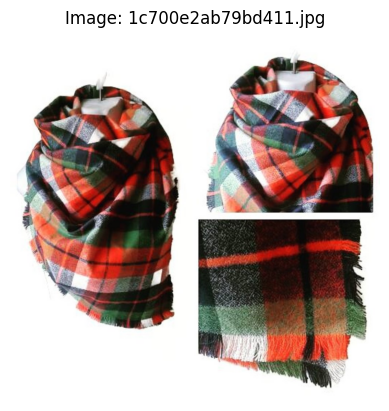

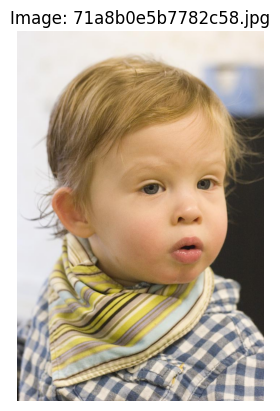

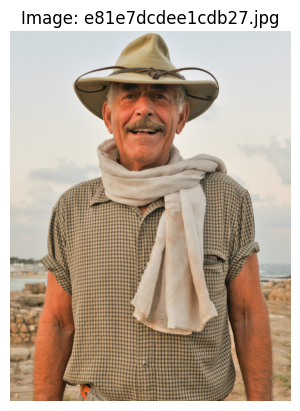

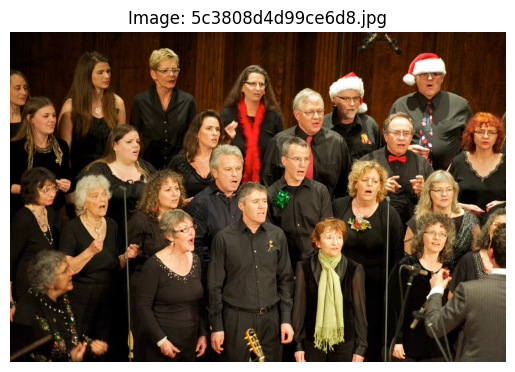

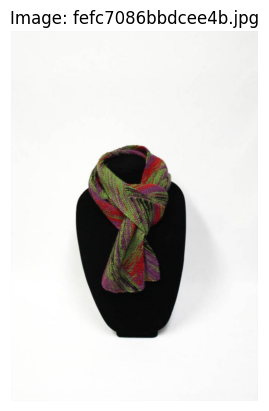

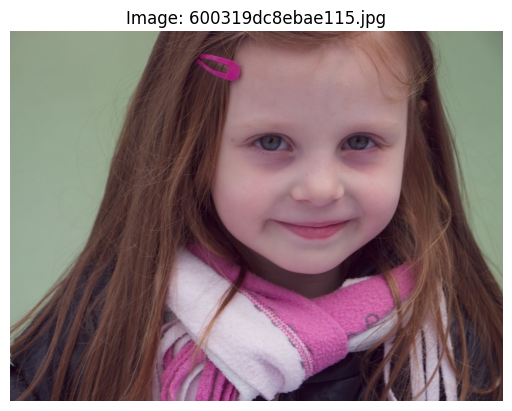

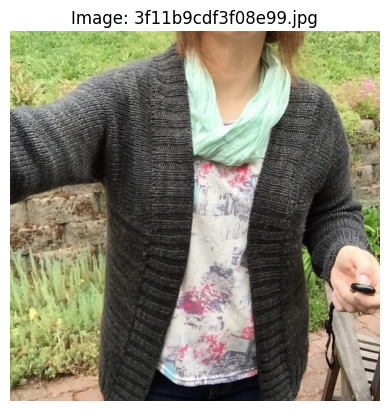

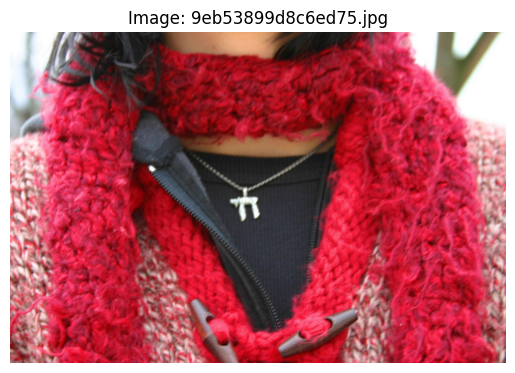

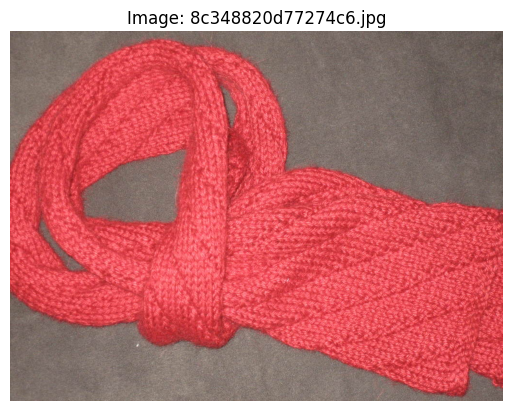

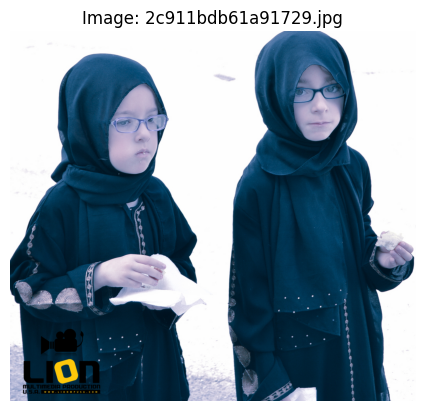

In [18]:
from PIL import Image
import requests
import os

from transformers import AutoProcessor, AutoModelForZeroShotObjectDetection
import matplotlib.pyplot as plt
import torch

processor = AutoProcessor.from_pretrained("google/owlvit-base-patch32")
model = AutoModelForZeroShotObjectDetection.from_pretrained("google/owlvit-base-patch32")


folder_path = "/content/OIDv4_ToolKit/OID/Dataset/test/Scarf"  # Replace with the actual path to your image folder

for filename in os.listdir(folder_path):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        image_path = os.path.join(folder_path, filename)
        image = Image.open(image_path)

        inputs = processor(text=["a scarf"], images=image, return_tensors="pt")
        outputs = model(**inputs)

        # Filter detections for "scarf" with confidence above a threshold
        target_sizes = torch.tensor([image.size[::-1]])
        results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

        # Display the image with bounding boxes
        plt.imshow(image)
        ax = plt.gca()
        for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
            box = [round(i, 2) for i in box.tolist()]
            if model.config.id2label[label.item()] == "a scarf":
                ax.add_patch(plt.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                           fill=False, edgecolor='red', linewidth=2))
                ax.text(box[0], box[1], f"{model.config.id2label[label.item()]}: {score.item():.3f}",
                        fontsize=12, bbox=dict(facecolor='yellow', alpha=0.5))

        plt.title(f"Image: {filename}")
        plt.axis('off')
        plt.show()

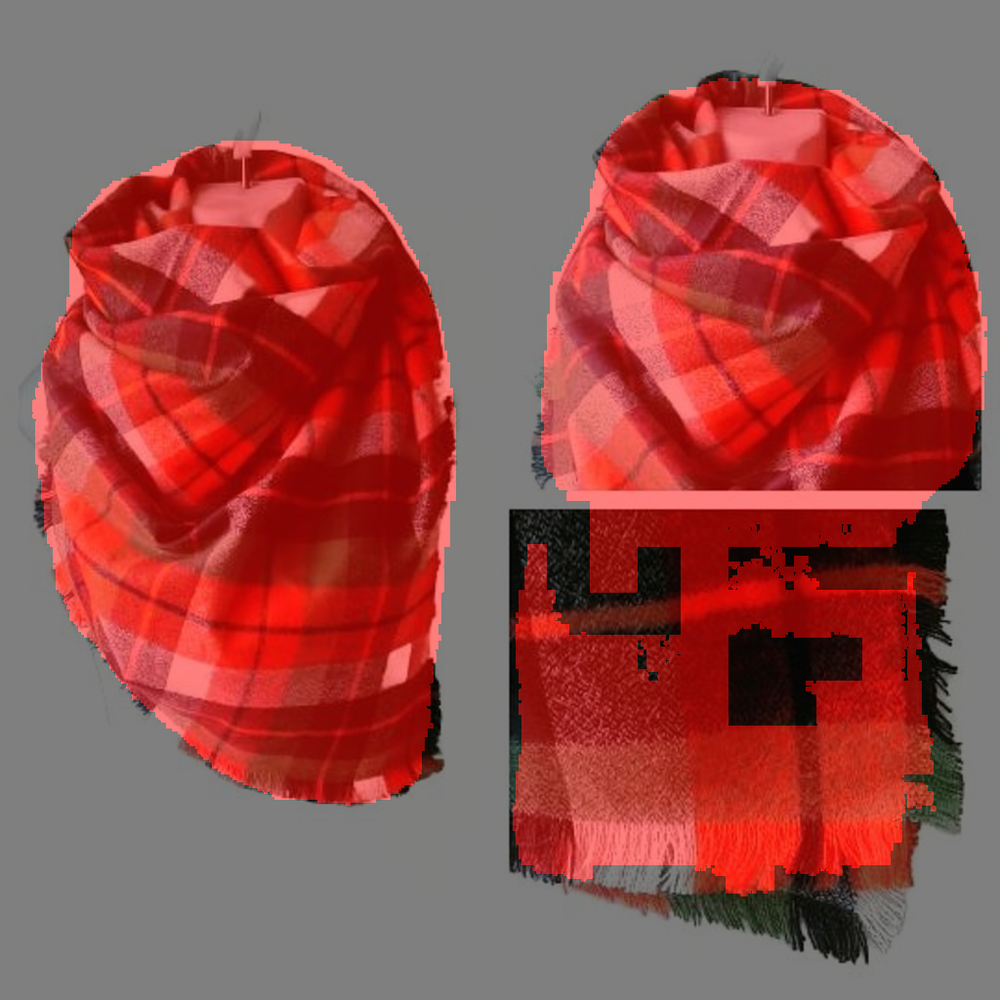

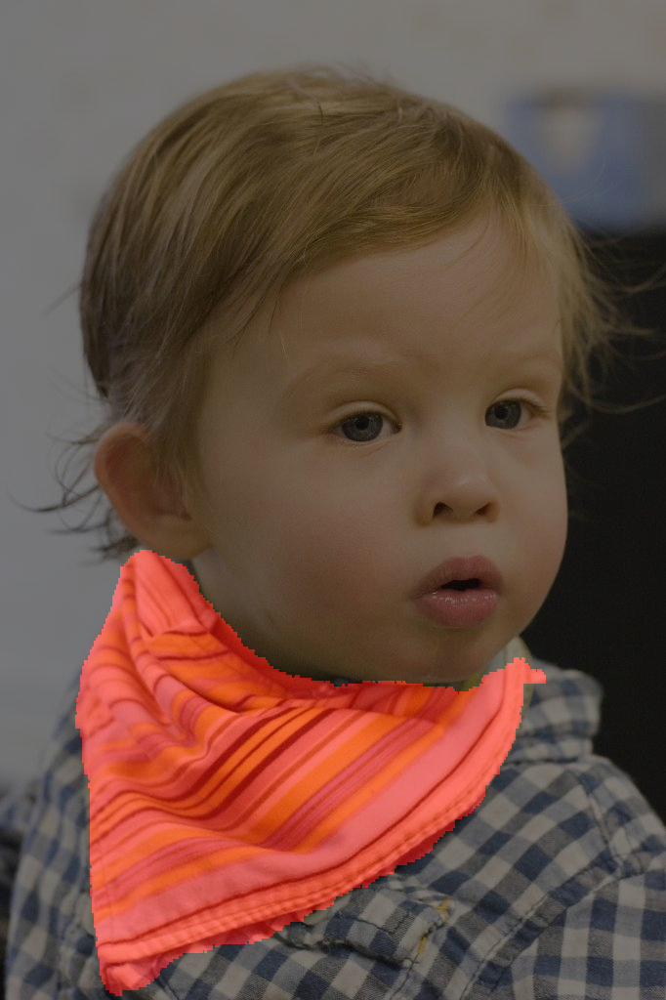

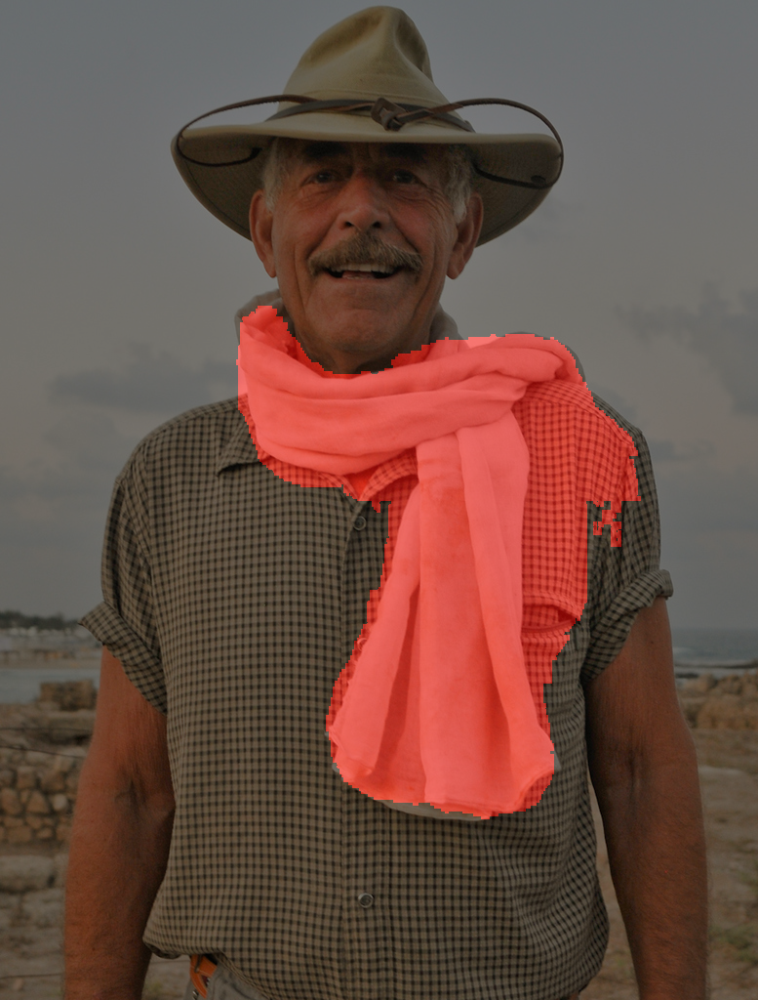

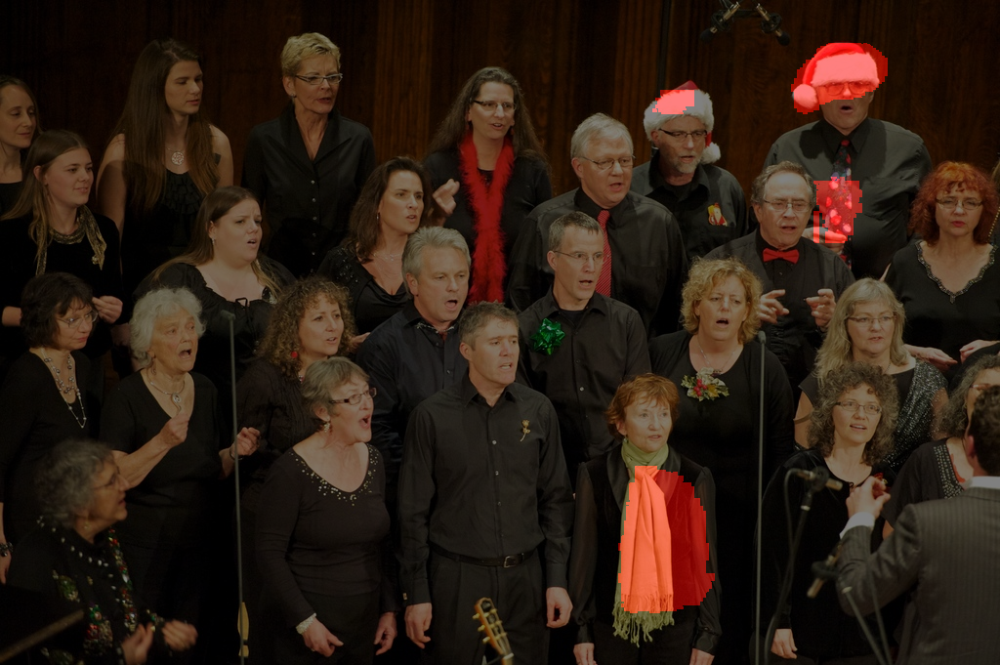

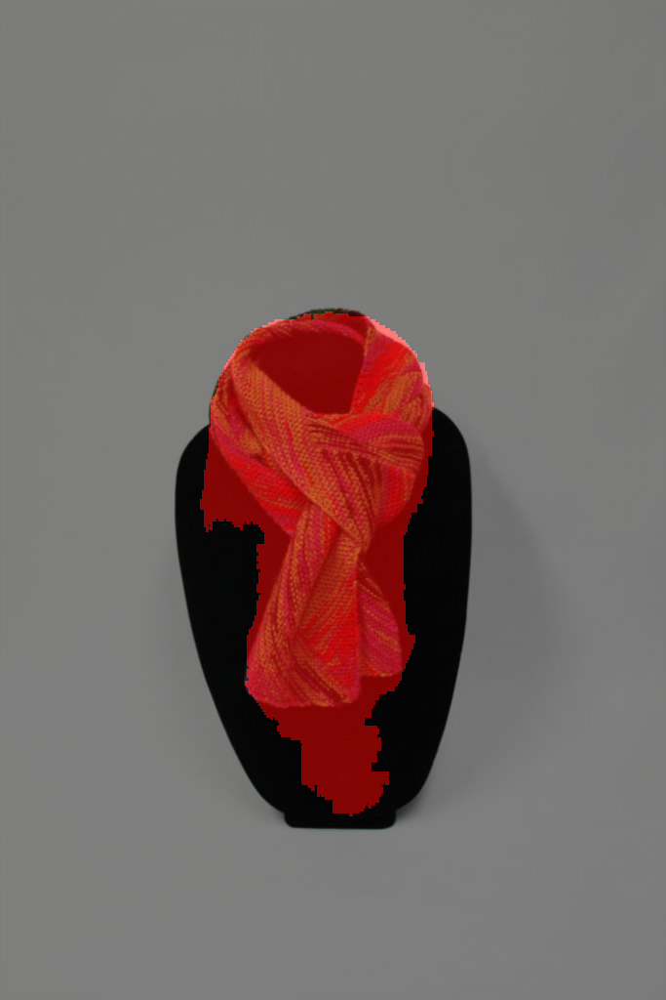

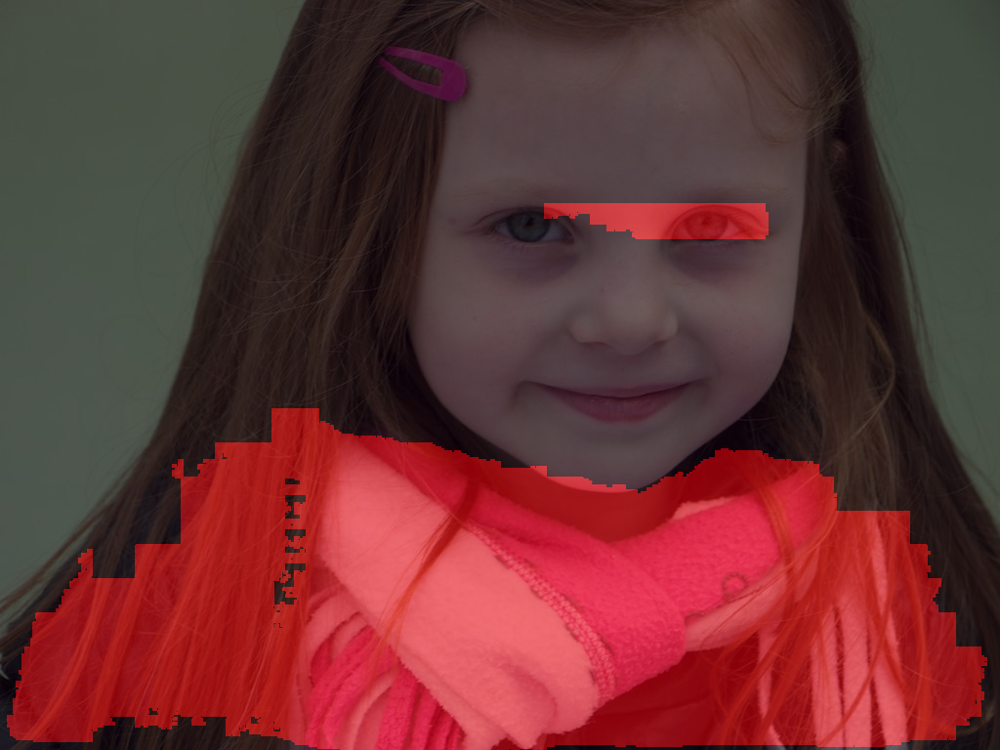

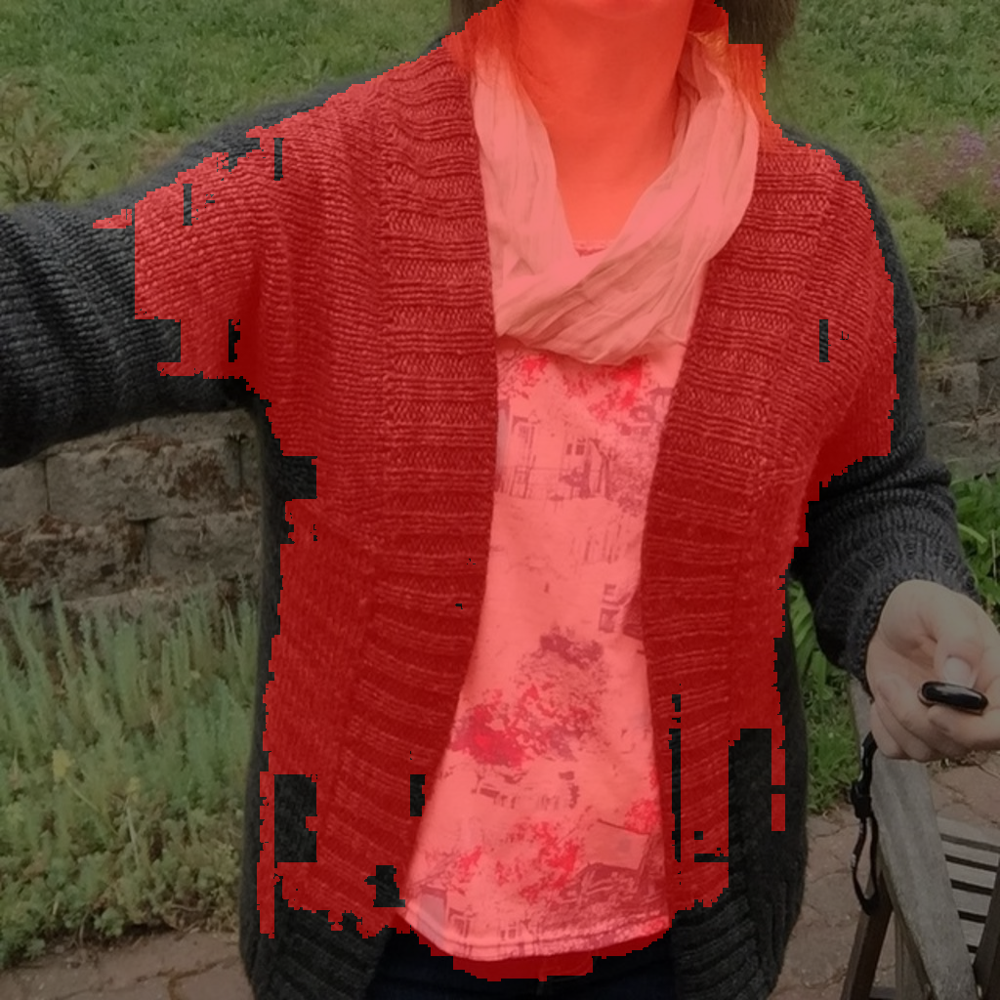

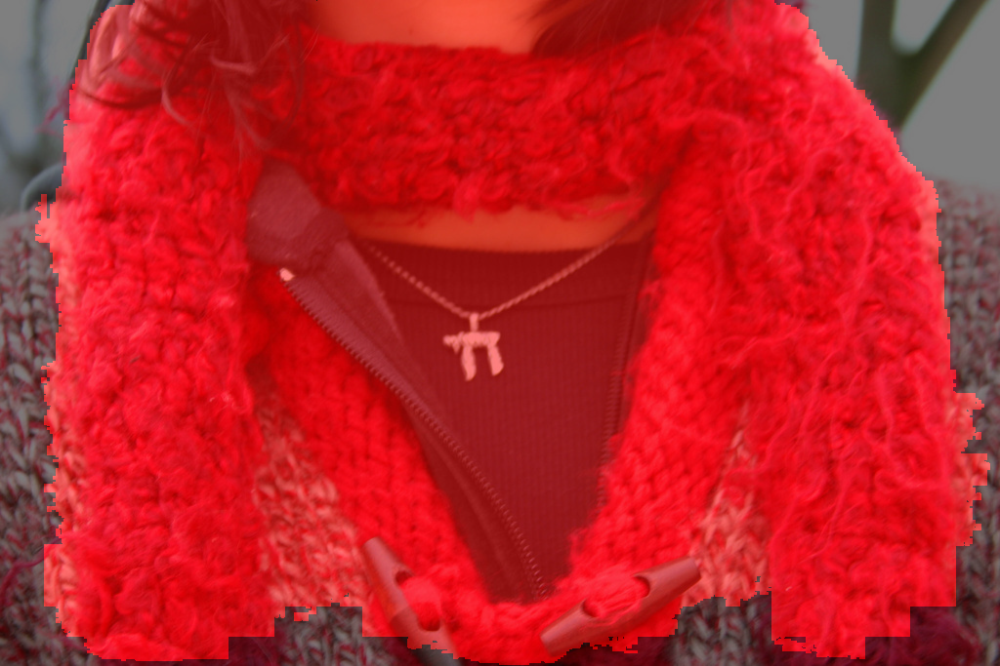

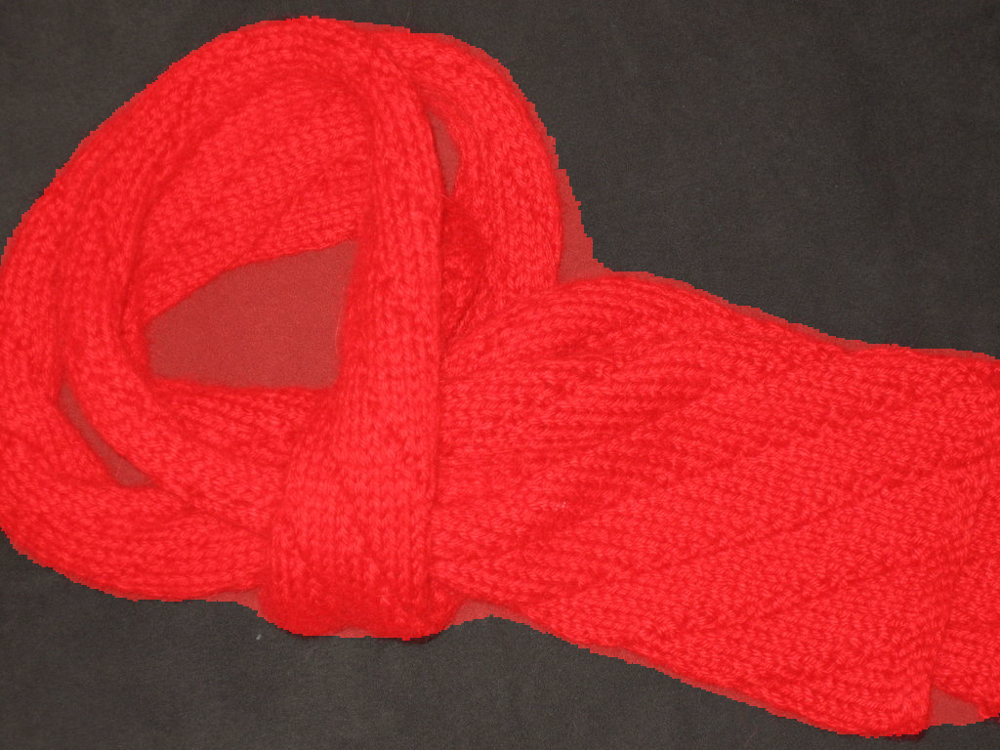

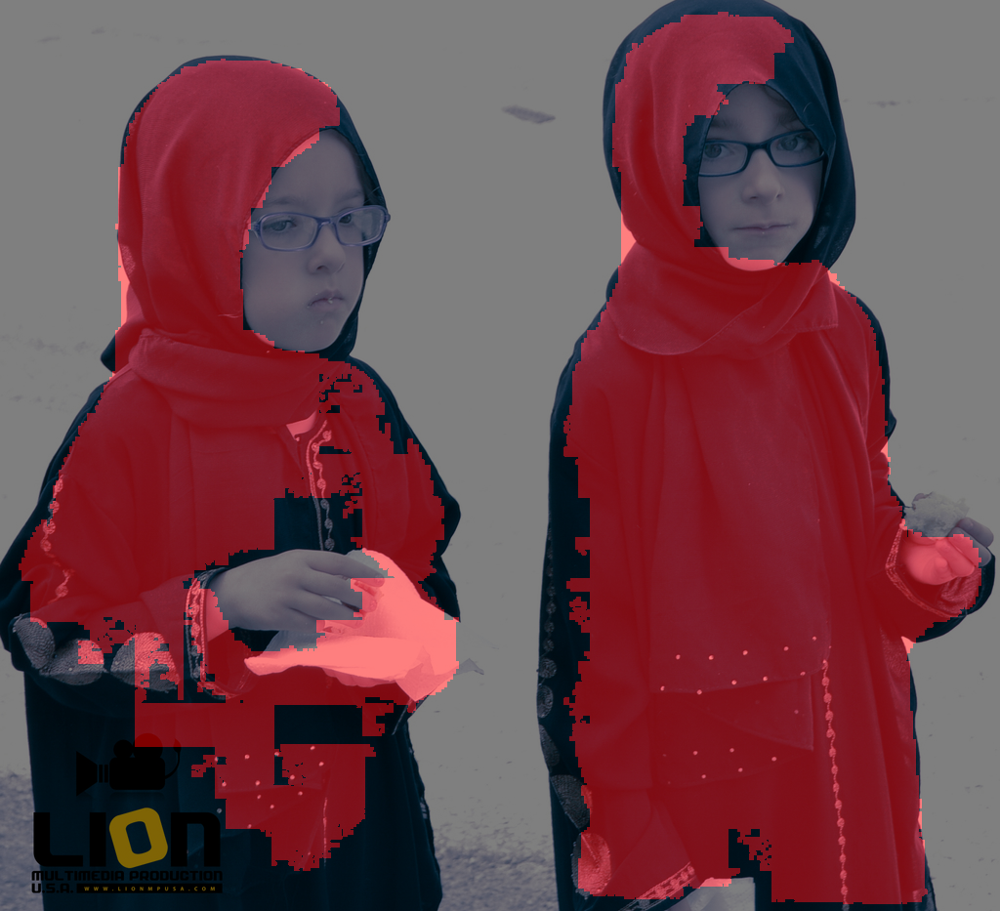

In [6]:
!pip install scikit-image

from PIL import Image
import numpy as np
import torch
from transformers import AutoProcessor, CLIPSegForImageSegmentation
from skimage import morphology
import os # Import the os module

# Load the pre-trained model and processor
processor = AutoProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

# Function to process a single image and return the mask
def segment_scarf(image_path):
    image = Image.open(image_path)

    # Use multiple, more specific prompts
    prompts = [
        "a child's scarf",
    "a winter scarf",
    "a knitted scarf",
    "a scarf around the neck",
    "a person wearing a scarf",
    "a colorful scarf",
    "a headscarf",  # Added for hijab
    "a hijab",  # Added specifically for hijab
    "a woman wearing a hijab",  # Added for context
    "a Muslim woman's headscarf"  # Added for cultural context
    ]

    # Process and predict for each prompt separately
    all_masks = []
    for prompt in prompts:
        inputs = processor(text=[prompt], images=image, return_tensors="pt", padding=True, truncation=True)
        outputs = model(**inputs)
        logits = outputs.logits.squeeze(0)
        probs = torch.sigmoid(logits)
        # Adjusted threshold for more inclusivity
        mask = probs > 0.45
        mask_np = mask.cpu().numpy().astype(np.uint8) * 255
        mask_np = np.array(Image.fromarray(mask_np).resize(image.size))
        all_masks.append(mask_np)

    # Combine the masks by taking the maximum value at each pixel
    combined_mask = np.max(all_masks, axis=0)

    # Post-processing: Remove small, disconnected regions (adjusted min_size)
    cleaned_mask = morphology.remove_small_objects(combined_mask.astype(bool), min_size=500).astype(np.uint8) * 255

    return cleaned_mask, image

# Path to your image folder
folder_path = "/content/OIDv4_ToolKit/OID/Dataset/test/Scarf"

# Process all images in the folder
for filename in os.listdir(folder_path):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        image_path = os.path.join(folder_path, filename)
        mask, original_image = segment_scarf(image_path)

        # Overlay the mask on the original image (for visualization)
        overlay = np.zeros_like(np.array(original_image))
        overlay[:, :, 0] = mask  # Set red channel for the mask
        overlay = Image.fromarray(overlay)
        blended = Image.blend(original_image, overlay, alpha=0.5)
        display(blended)